In [283]:
# Libs for data wrangling
import pandas as pd
import numpy as np
import missingno as msno
import pandas_profiling
import tqdm

# Libs for visualization
import seaborn as sns
import matplotlib.pyplot as plt
import plotly.express as px

# Overview of datasets

## Overview of Transaction sheet

#### Overall information

In [5]:
tr = pd.read_excel('KPMG_VI_New_raw_data_update_final.xlsx', 'Transactions', skiprows=1)

In [14]:
tr.dtypes.value_counts()

object            5
float64           4
int64             3
datetime64[ns]    1
dtype: int64

In [15]:
tr.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 20000 entries, 0 to 19999
Data columns (total 13 columns):
transaction_id             20000 non-null int64
product_id                 20000 non-null int64
customer_id                20000 non-null int64
transaction_date           20000 non-null datetime64[ns]
online_order               19640 non-null float64
order_status               20000 non-null object
brand                      19803 non-null object
product_line               19803 non-null object
product_class              19803 non-null object
product_size               19803 non-null object
list_price                 20000 non-null float64
standard_cost              19803 non-null float64
product_first_sold_date    19803 non-null float64
dtypes: datetime64[ns](1), float64(4), int64(3), object(5)
memory usage: 2.0+ MB


In [16]:
print(f'Amount of rows {tr.shape[0]} and amount of features {tr.shape[1]}')

Amount of rows 20000 and amount of features 13


In [17]:
tr.describe(include='all')

,transaction_id,product_id,customer_id,transaction_date,online_order,order_status,brand,product_line,product_class,product_size,list_price,standard_cost,product_first_sold_date
count,20000.000000,20000.00000,20000.000000,20000,19640.000000,20000,19803,19803,19803,19803,20000.000000,19803.000000,19803.000000
unique,NaN,NaN,NaN,364,NaN,2,6,4,3,3,NaN,NaN,NaN
top,NaN,NaN,NaN,2017-02-14 00:00:00,NaN,Approved,Solex,Standard,medium,medium,NaN,NaN,NaN
freq,NaN,NaN,NaN,82,NaN,19821,4253,14176,13826,12990,NaN,NaN,NaN
first,NaN,NaN,NaN,2017-01-01 00:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
last,NaN,NaN,NaN,2017-12-30 00:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
mean,10000.500000,45.36465,1738.246050,NaN,0.500458,NaN,NaN,NaN,NaN,NaN,1107.829449,556.046951,38199.776549
std,5773.647028,30.75359,1011.951046,NaN,0.500013,NaN,NaN,NaN,NaN,NaN,582.825242,405.955660,2875.201110
min,1.000000,0.00000,1.000000,NaN,0.000000,NaN,NaN,NaN,NaN,NaN,12.010000,7.210000,33259.000000
25%,5000.750000,18.00000,857.750000,NaN,0.000000,NaN,NaN,NaN,NaN,NaN,575.270000,215.140000,35667.000000


In [18]:
tr.describe()

,transaction_id,product_id,customer_id,online_order,list_price,standard_cost,product_first_sold_date
count,20000.000000,20000.00000,20000.000000,19640.000000,20000.000000,19803.000000,19803.000000
mean,10000.500000,45.36465,1738.246050,0.500458,1107.829449,556.046951,38199.776549
std,5773.647028,30.75359,1011.951046,0.500013,582.825242,405.955660,2875.201110
min,1.000000,0.00000,1.000000,0.000000,12.010000,7.210000,33259.000000
25%,5000.750000,18.00000,857.750000,0.000000,575.270000,215.140000,35667.000000
50%,10000.500000,44.00000,1736.000000,1.000000,1163.890000,507.580000,38216.000000
75%,15000.250000,72.00000,2613.000000,1.000000,1635.300000,795.100000,40672.000000
max,20000.000000,100.00000,5034.000000,1.000000,2091.470000,1759.850000,42710.000000


In [23]:
pandas_profiling.ProfileReport(tr)

### Missing values

In [66]:
missingv = (tr.isnull().sum()/len(tr)).to_frame().reset_index().rename({'index':'variable',
                                                            0: 'percent'}, axis=1)

In [71]:
missingv['percent'] = missingv['percent'].apply(lambda x: f'{x*100:.1f}%')

missingv['nums_obs'] = tr.isnull().sum().values

missingv.sort_values('nums_obs', ascending=False)[missingv['nums_obs'] >= 100]

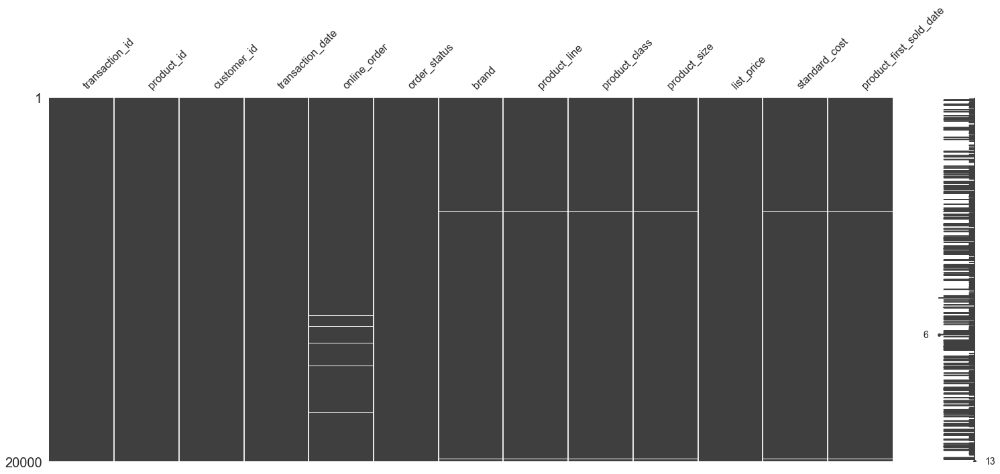

In [25]:
msno.matrix(tr)

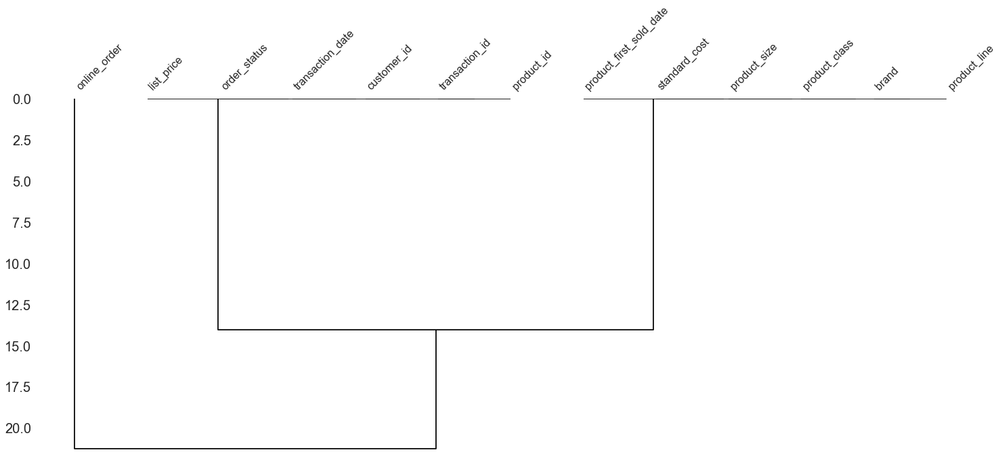

In [29]:
msno.dendrogram(tr)

In [73]:
# Checking transaction for last three months

In [97]:
tr.sort_values("transaction_date", ascending=False).head(1)

,transaction_id,product_id,customer_id,transaction_date,online_order,order_status,brand,product_line,product_class,product_size,list_price,standard_cost,product_first_sold_date
1696,1697,56,2421,2017-12-30,1.0,Approved,OHM Cycles,Standard,medium,medium,183.86,137.9,33259.0


In [85]:
last_date = tr.sort_values("transaction_date", ascending=False).head(1)['transaction_date'].values[0]

In [94]:
import datetime
from datetime import timedelta

In [89]:
type(last_date)

numpy.datetime64

In [92]:
ns = last_date-np.datetime64(3, 'M')

In [98]:
dt = datetime.datetime.fromtimestamp(ns // 1000000000)

<ipython-input-98-e6b6370a7dea>:1: DeprecationWarning:

an integer is required (got type numpy.timedelta64).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.



In [101]:
first_date = dt.strftime('%Y-%m-%d')

In [103]:
tr[tr['transaction_date'] >= first_date].sort_values('transaction_date', ascending=False)

,transaction_id,product_id,customer_id,transaction_date,online_order,order_status,brand,product_line,product_class,product_size,list_price,standard_cost,product_first_sold_date
13574,13575,98,2396,2017-12-30,0.0,Approved,Trek Bicycles,Standard,high,medium,358.39,215.03,33364.0
7546,7547,23,1407,2017-12-30,1.0,Approved,Norco Bicycles,Mountain,low,small,688.63,612.88,36334.0
1032,1033,49,934,2017-12-30,0.0,Approved,Trek Bicycles,Road,medium,medium,533.51,400.13,35707.0
4668,4669,29,1052,2017-12-30,0.0,Approved,WeareA2B,Standard,medium,medium,1065.03,230.09,36833.0
12452,12453,12,151,2017-12-30,0.0,Approved,WeareA2B,Standard,medium,medium,1231.15,161.60,40487.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...
779,780,94,1608,2017-10-01,0.0,Approved,Giant Bicycles,Standard,medium,large,1635.30,993.66,38002.0
17350,17351,82,1247,2017-10-01,0.0,Approved,Norco Bicycles,Standard,high,medium,1148.64,689.18,42226.0
18488,18489,13,1357,2017-10-01,1.0,Approved,Solex,Standard,medium,medium,1577.53,826.51,40618.0
2621,2622,52,1613,2017-10-01,0.0,Approved,OHM Cycles,Road,medium,medium,1280.28,829.51,37220.0


### Conculsion:

- 20,000 observations and 13 variables
- No duplicates
- Most of the data are categorical type
- Numerical data are date type
- 0.6% are missing
- There are 5080 observations for last three months

## Overview of list of customers

In [104]:
lc = pd.read_excel('KPMG_VI_New_raw_data_update_final.xlsx', 'NewCustomerList', skiprows=1)

In [105]:
lc.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1000 entries, 0 to 999
Data columns (total 23 columns):
first_name                             1000 non-null object
last_name                              971 non-null object
gender                                 1000 non-null object
past_3_years_bike_related_purchases    1000 non-null int64
DOB                                    983 non-null datetime64[ns]
job_title                              894 non-null object
job_industry_category                  835 non-null object
wealth_segment                         1000 non-null object
deceased_indicator                     1000 non-null object
owns_car                               1000 non-null object
tenure                                 1000 non-null int64
address                                1000 non-null object
postcode                               1000 non-null int64
state                                  1000 non-null object
country                                1000 non-null 

In [108]:
lc.dtypes.value_counts()

object            11
int64              6
float64            5
datetime64[ns]     1
dtype: int64

In [110]:
lc.describe()

,past_3_years_bike_related_purchases,tenure,postcode,property_valuation,Unnamed: 16,Unnamed: 17,Unnamed: 18,Unnamed: 19,Unnamed: 20,Rank,Value
count,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000
mean,49.836000,11.388000,3019.227000,7.397000,0.747340,0.839005,0.942673,0.870514,498.819000,498.819000,0.881714
std,27.796686,5.037145,848.895767,2.758804,0.205082,0.248858,0.294832,0.280891,288.810997,288.810997,0.293525
min,0.000000,0.000000,2000.000000,1.000000,0.400000,0.400000,0.400000,0.340000,1.000000,1.000000,0.340000
25%,26.750000,7.000000,2209.000000,6.000000,0.570000,0.637500,0.712500,0.658750,250.000000,250.000000,0.649531
50%,51.000000,11.000000,2800.000000,8.000000,0.750000,0.820000,0.912500,0.842625,500.000000,500.000000,0.860000
75%,72.000000,15.000000,3845.500000,9.000000,0.920000,1.031875,1.142969,1.062500,750.250000,750.250000,1.075000
max,99.000000,22.000000,4879.000000,12.000000,1.100000,1.375000,1.718750,1.718750,1000.000000,1000.000000,1.718750


In [111]:
lc.describe(include='all')

,first_name,last_name,gender,past_3_years_bike_related_purchases,DOB,job_title,job_industry_category,wealth_segment,deceased_indicator,owns_car,...,state,country,property_valuation,Unnamed: 16,Unnamed: 17,Unnamed: 18,Unnamed: 19,Unnamed: 20,Rank,Value
count,1000,971,1000,1000.000000,983,894,835,1000,1000,1000,...,1000,1000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000
unique,940,961,3,NaN,958,184,9,3,1,2,...,3,1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
top,Mandie,Sturch,Female,NaN,1961-07-31 00:00:00,Associate Professor,Financial Services,Mass Customer,N,No,...,NSW,Australia,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
freq,3,2,513,NaN,2,15,203,508,1000,507,...,506,1000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
first,NaN,NaN,NaN,NaN,1938-06-08 00:00:00,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
last,NaN,NaN,NaN,NaN,2002-02-27 00:00:00,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
mean,NaN,NaN,NaN,49.836000,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,7.397000,0.747340,0.839005,0.942673,0.870514,498.819000,498.819000,0.881714
std,NaN,NaN,NaN,27.796686,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,2.758804,0.205082,0.248858,0.294832,0.280891,288.810997,288.810997,0.293525
min,NaN,NaN,NaN,0.000000,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,1.000000,0.400000,0.400000,0.400000,0.340000,1.000000,1.000000,0.340000
25%,NaN,NaN,NaN,26.750000,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,6.000000,0.570000,0.637500,0.712500,0.658750,250.000000,250.000000,0.649531


In [112]:
lc.sample(5)

,first_name,last_name,gender,past_3_years_bike_related_purchases,DOB,job_title,job_industry_category,wealth_segment,deceased_indicator,owns_car,...,state,country,property_valuation,Unnamed: 16,Unnamed: 17,Unnamed: 18,Unnamed: 19,Unnamed: 20,Rank,Value
357,Otis,NaN,Male,59,1971-01-11,Electrical Engineer,Manufacturing,Affluent Customer,N,No,...,NSW,Australia,11,0.68,0.6800,0.85000,0.85000,358,358,0.9800
624,Ardis,Taree,Female,97,1960-04-12,Chemical Engineer,Manufacturing,Affluent Customer,N,Yes,...,QLD,Australia,9,0.62,0.7750,0.96875,0.96875,625,625,0.7480
304,Manya,Abramovici,Female,42,1955-07-17,Quality Engineer,Financial Services,High Net Worth,N,Yes,...,QLD,Australia,8,1.05,1.3125,1.31250,1.31250,304,304,1.0250
198,Leonid,Dorricott,Male,44,1993-11-18,Environmental Tech,NaN,Affluent Customer,N,No,...,NSW,Australia,3,0.46,0.4600,0.46000,0.46000,195,195,1.1475
761,Petr,Westman,Male,5,1987-11-02,Nurse Practicioner,Property,Mass Customer,N,No,...,QLD,Australia,7,0.77,0.7700,0.77000,0.65450,760,760,0.6375


In [113]:
lc.columns

Index(['first_name', 'last_name', 'gender',
       'past_3_years_bike_related_purchases', 'DOB', 'job_title',
       'job_industry_category', 'wealth_segment', 'deceased_indicator',
       'owns_car', 'tenure', 'address', 'postcode', 'state', 'country',
       'property_valuation', 'Unnamed: 16', 'Unnamed: 17', 'Unnamed: 18',
       'Unnamed: 19', 'Unnamed: 20', 'Rank', 'Value'],
      dtype='object')

In [115]:
print(f'Observations: {lc.shape[0]}; Variables: {lc.shape[1]}')

Observations: 1000; Variables: 23


In [126]:
pandas_profiling.ProfileReport(lc)

### Missing values

In [125]:
missingv = (lc.isnull().sum()/len(lc)).to_frame().reset_index().rename({'index':'variable',
                                                            0: 'percent'}, axis=1)
missingv['percent'] = missingv['percent'].apply(lambda x: f'{x*100:.1f}%')

missingv['nums_obs'] = lc.isnull().sum().values

missingv.sort_values('nums_obs', ascending=False)[missingv['nums_obs'] > 10]

<ipython-input-125-acdf38042780>:7: UserWarning:

Boolean Series key will be reindexed to match DataFrame index.



,variable,percent,nums_obs
6,job_industry_category,16.5%,165
5,job_title,10.6%,106
1,last_name,2.9%,29
4,DOB,1.7%,17


### Deleting columns with no values

In [127]:
del lc['Unnamed: 16']
del lc['Unnamed: 17']
del lc['Unnamed: 18']
del lc['Unnamed: 19']


In [134]:
lc['DOB'].sort_values()

797   1938-06-08
885   1938-06-09
769   1938-08-05
585   1938-08-30
265   1938-08-31
         ...    
775          NaT
835          NaT
883          NaT
904          NaT
984          NaT
Name: DOB, Length: 1000, dtype: datetime64[ns]

In [191]:
timed = lc['DOB'].dropna().apply(lambda x: datetime.datetime.strftime(x, '%Y')).value_counts().sort_values(ascending=False)

In [200]:
timed = timed.to_frame().reset_index()
timed['index'] = timed['index'].astype(str)

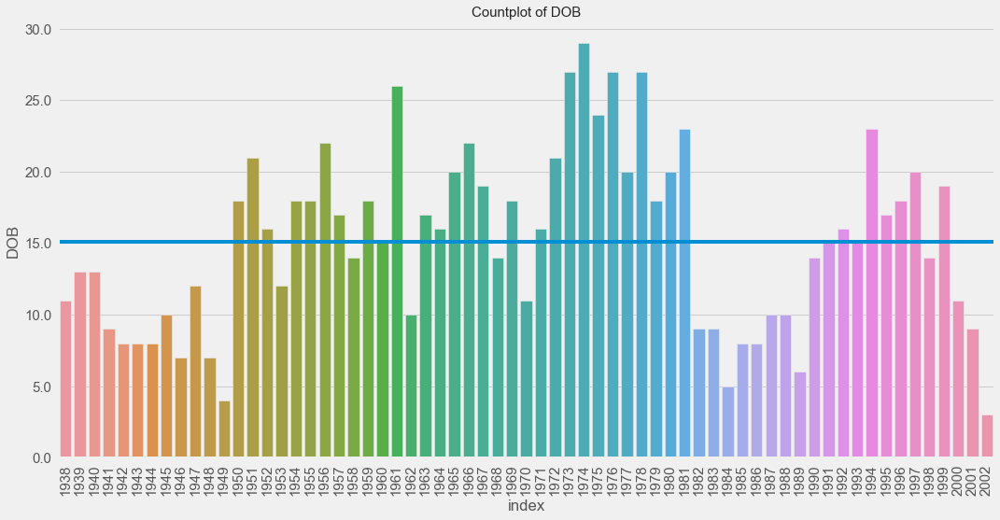

In [245]:
plt.style.use('fivethirtyeight')
              
plt.figure(figsize=(16, 8))
fig = sns.barplot(data=timed, x='index', y='DOB')
# Showing yticks
fig.set_yticklabels(fig.get_yticks(), size = 15)
# Setting xticks
_, xlabels = plt.xticks()
fig.set_xticklabels(xlabels, size = 15)
# Setting title
fig.set_title('Countplot of DOB', fontdict={'fontsize':15
})
# Setting hline
plt.axhline(timed['DOB'].mean())
              
plt.xticks(rotation=90)
plt.show()

## Overview of customer demographic

In [248]:
cd = pd.read_excel('KPMG_VI_New_raw_data_update_final.xlsx', 'CustomerDemographic', skiprows=1)

In [250]:
pandas_profiling.ProfileReport(cd)

In [251]:
cd.info()


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 4000 entries, 0 to 3999
Data columns (total 13 columns):
customer_id                            4000 non-null int64
first_name                             4000 non-null object
last_name                              3875 non-null object
gender                                 4000 non-null object
past_3_years_bike_related_purchases    4000 non-null int64
DOB                                    3913 non-null datetime64[ns]
job_title                              3494 non-null object
job_industry_category                  3344 non-null object
wealth_segment                         4000 non-null object
deceased_indicator                     4000 non-null object
default                                3698 non-null object
owns_car                               4000 non-null object
tenure                                 3913 non-null float64
dtypes: datetime64[ns](1), float64(1), int64(2), object(9)
memory usage: 406.4+ KB


In [253]:
cd.dtypes.value_counts()

object            9
int64             2
datetime64[ns]    1
float64           1
dtype: int64

In [254]:
cd.describe()

,customer_id,past_3_years_bike_related_purchases,tenure
count,4000.000000,4000.000000,3913.000000
mean,2000.500000,48.890000,10.657041
std,1154.844867,28.715005,5.660146
min,1.000000,0.000000,1.000000
25%,1000.750000,24.000000,6.000000
50%,2000.500000,48.000000,11.000000
75%,3000.250000,73.000000,15.000000
max,4000.000000,99.000000,22.000000


In [256]:
cd.describe(include='all')

,customer_id,first_name,last_name,gender,past_3_years_bike_related_purchases,DOB,job_title,job_industry_category,wealth_segment,deceased_indicator,default,owns_car,tenure
count,4000.000000,4000,3875,4000,4000.000000,3913,3494,3344,4000,4000,3698.0,4000,3913.000000
unique,NaN,3139,3725,6,NaN,3448,195,9,3,2,90.0,2,NaN
top,NaN,Tobe,Ramsdell,Female,NaN,1978-01-30 00:00:00,Business Systems Development Analyst,Manufacturing,Mass Customer,N,100.0,Yes,NaN
freq,NaN,5,3,2037,NaN,7,45,799,2000,3998,113.0,2024,NaN
first,NaN,NaN,NaN,NaN,NaN,1843-12-21 00:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN
last,NaN,NaN,NaN,NaN,NaN,2002-03-11 00:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN
mean,2000.500000,NaN,NaN,NaN,48.890000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,10.657041
std,1154.844867,NaN,NaN,NaN,28.715005,NaN,NaN,NaN,NaN,NaN,NaN,NaN,5.660146
min,1.000000,NaN,NaN,NaN,0.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.000000
25%,1000.750000,NaN,NaN,NaN,24.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,6.000000


### Consistency of Data

- Gender variables is not consistent

In [258]:
cd['gender'].unique()

array(['F', 'Male', 'Female', 'U', 'Femal', 'M'], dtype=object)

In [261]:
cd['DOB'].sort_values().nsmallest(10)
# Too distinct values in 'DOB' variable

33     1843-12-21
719    1931-10-23
1091   1935-08-22
3409   1940-09-22
2412   1943-08-11
657    1944-01-24
1242   1953-08-09
1564   1953-08-17
1176   1953-08-31
3470   1953-09-05
Name: DOB, dtype: datetime64[ns]

### Missing values

In [262]:
missingv = (lc.isnull().sum()/len(lc)).to_frame().reset_index().rename({'index':'variable',
                                                            0: 'percent'}, axis=1)
missingv['percent'] = missingv['percent'].apply(lambda x: f'{x*100:.1f}%')

missingv['nums_obs'] = lc.isnull().sum().values

missingv.sort_values('nums_obs', ascending=False)[missingv['nums_obs'] > 10]

<ipython-input-262-acdf38042780>:7: UserWarning:

Boolean Series key will be reindexed to match DataFrame index.



,variable,percent,nums_obs
6,job_industry_category,16.5%,165
5,job_title,10.6%,106
1,last_name,2.9%,29
4,DOB,1.7%,17


In [302]:
# we can delete variable 'default' due to insignificance
del cd['default']

## Overview of CustomerAddress

In [263]:
ca = pd.read_excel('KPMG_VI_New_raw_data_update_final.xlsx', 'CustomerAddress', skiprows=1)

In [264]:
ca.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3999 entries, 0 to 3998
Data columns (total 6 columns):
customer_id           3999 non-null int64
address               3999 non-null object
postcode              3999 non-null int64
state                 3999 non-null object
country               3999 non-null object
property_valuation    3999 non-null int64
dtypes: int64(3), object(3)
memory usage: 187.6+ KB


In [267]:
print(f'Number of observations:{ca.shape[0]}'\
      f'\nNumber of variables {ca.shape[1]}')

Number of observations:3999
Number of variables 6


In [268]:
ca.sample(5)

,customer_id,address,postcode,state,country,property_valuation
906,911,5 Farmco Way,2747,NSW,Australia,8
365,370,06324 Michigan Trail,4570,QLD,Australia,4
595,600,0 Rigney Way,2148,NSW,Australia,8
1616,1621,48 Melby Trail,2131,NSW,Australia,8
3918,3923,1 Banding Way,4218,QLD,Australia,8


In [269]:
ca.dtypes

customer_id            int64
address               object
postcode               int64
state                 object
country               object
property_valuation     int64
dtype: object

In [270]:
ca.dtypes.value_counts()

int64     3
object    3
dtype: int64

In [271]:
ca.describe()

,customer_id,postcode,property_valuation
count,3999.000000,3999.000000,3999.000000
mean,2003.987997,2985.755939,7.514379
std,1154.576912,844.878364,2.824663
min,1.000000,2000.000000,1.000000
25%,1004.500000,2200.000000,6.000000
50%,2004.000000,2768.000000,8.000000
75%,3003.500000,3750.000000,10.000000
max,4003.000000,4883.000000,12.000000


In [272]:
ca.describe(include='all')

,customer_id,address,postcode,state,country,property_valuation
count,3999.000000,3999,3999.000000,3999,3999,3999.000000
unique,NaN,3996,NaN,5,1,NaN
top,NaN,64 Macpherson Junction,NaN,NSW,Australia,NaN
freq,NaN,2,NaN,2054,3999,NaN
mean,2003.987997,NaN,2985.755939,NaN,NaN,7.514379
std,1154.576912,NaN,844.878364,NaN,NaN,2.824663
min,1.000000,NaN,2000.000000,NaN,NaN,1.000000
25%,1004.500000,NaN,2200.000000,NaN,NaN,6.000000
50%,2004.000000,NaN,2768.000000,NaN,NaN,8.000000
75%,3003.500000,NaN,3750.000000,NaN,NaN,10.000000


In [273]:
pandas_profiling.ProfileReport(ca)

### Accuracy values

- Data has high accuracy

### Consistency of data


- Data is partly consistent
- There is inconsistent values such as Vic/Victoria in 'State' variable
- It should be cleaned

### Data is up-to date

- Data is up-to date

### Missing values

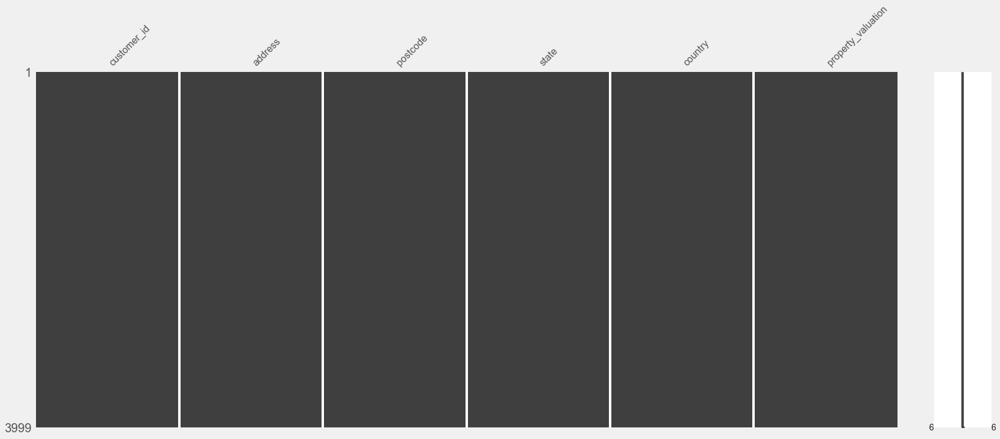

In [274]:
msno.matrix(ca)

---
- Data is full
---

## Conclusion

---
- Sheets Transaction, Customer Demographics and new list have missing values, it can skew our data. Some values can be dropped due to insignificance.
- No duplicates
- Some variables have inconsistent data. It will be cleaned.
- Challanges in imputation and working with missing values
---

## Recommendations

---
- To prevent inconsistency in data. It would be better to make dropdown list, not text input.
- To prevent missing values. We can make entering data as required fields, if variables are important for analysis.
---

# Data Cleaning

---
- Task: Recommend which of these 1000 new customers should be targeted to drive the most value for the organisation
---

### How to criterias for choosing most valuable customers?

### Questions:
- What state generate most of the revenues?
- How different purchase behavior between genders?
- What bike company generates is top 1?
- What job position purhase the most?
- Why There are people buying bike so often?
- What segment companies emphasize their attention?
- Product line?
- What age are making the most of valuable transaction?
- In what age people are doing their first transaction?

### Date for cleaning
- In CustomerAddress we should rename state variable
- In customer demographics, we chould clean gender
- etc.

### Cleaning State variable in Customer Address

In [377]:
# Renaming states in customer address
def rename_state(x):
    if x == 'Victoria':
        return 'VIC'
    elif x == 'New South Wales':
        return 'NSW'
    else:
        return x

In [284]:
tqdm.tqdm.pandas()

/Library/Frameworks/Python.framework/Versions/3.8/lib/python3.8/site-packages/tqdm/std.py:668: FutureWarning:

The Panel class is removed from pandas. Accessing it from the top-level namespace will also be removed in the next version



In [378]:
ca['state'] = ca['state'].progress_apply(rename_state)

100%|██████████| 3999/3999 [00:00<00:00, 529936.55it/s]


In [379]:
ca['state'].unique()

array(['NSW', 'QLD', 'VIC'], dtype=object)

### Cleaning Gender variable in Customer demographics

In [295]:
cd['gender'].unique()

array(['F', 'Male', 'Female', 'U', 'Femal', 'M'], dtype=object)

In [296]:
def clean_gender(gen):
    if gen == 'F' or gen == 'Femal' or gen == 'Female':
        return 'Female'
    if gen == 'Male' or gen == 'M':
        return 'Male'
    else:
        return 'U'

In [297]:
cd['gender'] = cd['gender'].progress_apply(clean_gender)

100%|██████████| 4000/4000 [00:00<00:00, 160668.98it/s]


In [300]:
# Check our cleaned data
cd['gender'].unique()

array(['Female', 'Male', 'U'], dtype=object)

### Joining data
- Common variable to join on
- Method Join Left, because transaction is our main dataframe
---

In [327]:
pd.set_option('display.max_columns', 50)

In [381]:
common_df = tr.set_index('customer_id').join(cd.set_index('customer_id'), on='customer_id', how='left', lsuffix='_tr', rsuffix='_cd')
# Join method works well, when common column names is index
# another option
# test_df = tr.merge(cd, how='left', on='customer_id', suffixes=('_tr', '_cd'))

In [346]:
common_df.columns

Index(['customer_id', 'transaction_id', 'product_id', 'transaction_date',
       'online_order', 'order_status', 'brand', 'product_line',
       'product_class', 'product_size', 'list_price', 'standard_cost',
       'product_first_sold_date', 'first_name', 'last_name', 'gender',
       'past_3_years_bike_related_purchases', 'DOB', 'job_title',
       'job_industry_category', 'wealth_segment', 'deceased_indicator',
       'owns_car', 'tenure'],
      dtype='object')

In [334]:
common_df.isnull().sum()

transaction_id                            0
product_id                                0
transaction_date                          0
online_order                            360
order_status                              0
brand                                   197
product_line                            197
product_class                           197
product_size                            197
list_price                                0
standard_cost                           197
product_first_sold_date                 197
first_name                                3
last_name                               645
gender                                    3
past_3_years_bike_related_purchases       3
DOB                                     449
job_title                              2397
job_industry_category                  3232
wealth_segment                            3
deceased_indicator                        3
owns_car                                  3
tenure                          

In [335]:
common_df.reset_index(inplace=True)

In [337]:
common_df[common_df['job_title'].isnull()].sample(5)

,customer_id,transaction_id,product_id,transaction_date,online_order,order_status,brand,product_line,product_class,product_size,list_price,standard_cost,product_first_sold_date,first_name,last_name,gender,past_3_years_bike_related_purchases,DOB,job_title,job_industry_category,wealth_segment,deceased_indicator,owns_car,tenure
11405,336,11406,46,2017-07-07,0.0,Approved,OHM Cycles,Standard,low,medium,1793.43,248.82,36361.0,Georgiana,Wallington,Female,91.0,1980-01-06,NaN,Manufacturing,High Net Worth,N,No,3.0
915,1368,916,76,2017-02-27,1.0,Approved,WeareA2B,Standard,low,medium,642.31,513.85,41922.0,Aarika,Magog,Female,54.0,1973-04-14,NaN,Property,Mass Customer,N,No,4.0
15029,2574,15030,50,2017-11-12,NaN,Approved,WeareA2B,Standard,medium,small,175.89,131.92,37668.0,Humfrey,Boyse,Male,73.0,1979-12-21,NaN,Manufacturing,Mass Customer,N,No,4.0
5224,2250,5225,80,2017-08-28,0.0,Approved,Trek Bicycles,Standard,medium,large,1469.44,596.55,41047.0,De witt,Gleave,Male,72.0,1992-06-26,NaN,Telecommunications,High Net Worth,N,No,7.0
15935,874,15936,5,2017-11-14,1.0,Approved,Trek Bicycles,Mountain,low,medium,574.64,459.71,38216.0,Howard,Oseland,Male,78.0,2001-05-05,NaN,Health,Mass Customer,N,Yes,1.0


In [338]:
common_df[common_df['job_title'].isnull()]['customer_id'].value_counts()

1068    14
2912    13
1783    12
2036    12
2574    11
        ..
2532     1
3161     1
1757     1
161      1
2271     1
Name: customer_id, Length: 424, dtype: int64

In [382]:
# Merging dataframes
common_df = common_df.merge(ca, on='customer_id', how='left', suffixes=('_tr', '_ca'))

In [349]:
common_df.columns

Index(['customer_id', 'transaction_id', 'product_id', 'transaction_date',
       'online_order', 'order_status', 'brand', 'product_line',
       'product_class', 'product_size', 'list_price', 'standard_cost',
       'product_first_sold_date', 'first_name', 'last_name', 'gender',
       'past_3_years_bike_related_purchases', 'DOB', 'job_title',
       'job_industry_category', 'wealth_segment', 'deceased_indicator',
       'owns_car', 'tenure', 'address', 'postcode', 'state', 'country',
       'property_valuation'],
      dtype='object')

In [350]:
common_df.shape

(20000, 29)

In [351]:
# After joining tables there are 29 variables

In [352]:
common_df.isnull().sum()

customer_id                               0
transaction_id                            0
product_id                                0
transaction_date                          0
online_order                            360
order_status                              0
brand                                   197
product_line                            197
product_class                           197
product_size                            197
list_price                                0
standard_cost                           197
product_first_sold_date                 197
first_name                                3
last_name                               645
gender                                    3
past_3_years_bike_related_purchases       3
DOB                                     449
job_title                              2397
job_industry_category                  3232
wealth_segment                            3
deceased_indicator                        3
owns_car                        

### Missing values

In [358]:
missingv = (common_df.isnull().sum()/len(common_df)).to_frame().reset_index().rename({'index':'variable',
                                                            0: 'percent'}, axis=1)
missingv['percent'] = missingv['percent'].apply(lambda x: f'{x*100:.1f}%')

missingv['nums_obs'] = common_df.isnull().sum().values

missingv.sort_values('nums_obs', ascending=False)[missingv['nums_obs'] > 10]

<ipython-input-358-f295f566face>:7: UserWarning:

Boolean Series key will be reindexed to match DataFrame index.



,variable,percent,nums_obs
19,job_industry_category,16.2%,3232
18,job_title,12.0%,2397
14,last_name,3.2%,645
17,DOB,2.2%,449
23,tenure,2.2%,449
4,online_order,1.8%,360
6,brand,1.0%,197
7,product_line,1.0%,197
8,product_class,1.0%,197
9,product_size,1.0%,197


<ipython-input-359-013a5706dde7>:1: UserWarning:

Boolean Series key will be reindexed to match DataFrame index.



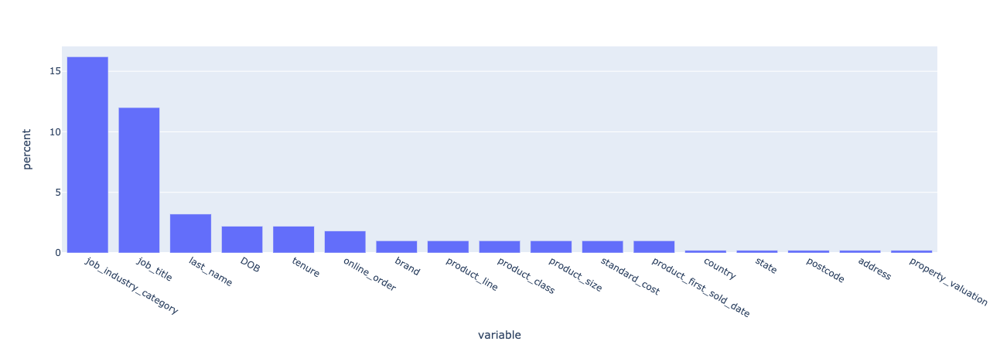

In [359]:
px_m = missingv.sort_values('nums_obs', ascending=False)[missingv['nums_obs'] > 10]

px.bar(px_m, x='variable', y='percent')

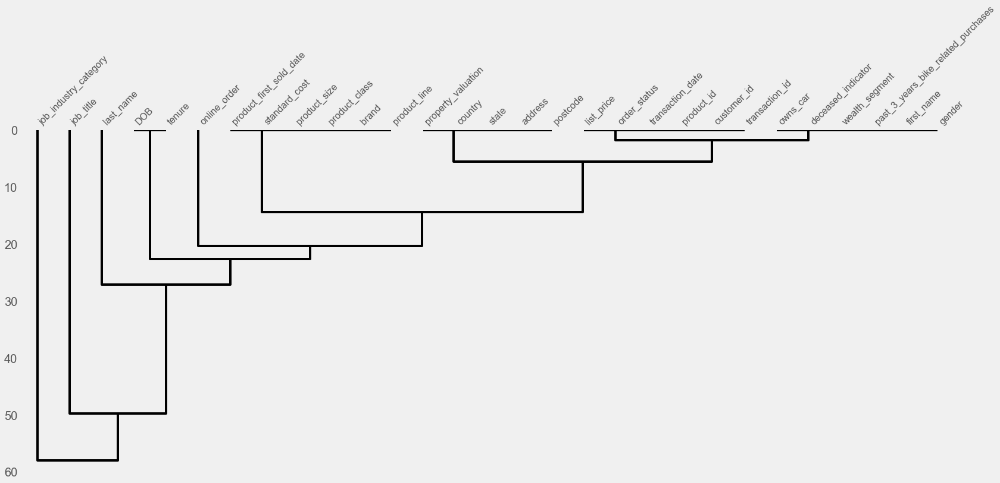

In [361]:
msno.dendrogram(common_df)

### Analysis without na values

In [362]:
common_df_nn = common_df.copy()

In [363]:
common_df_nn.dropna(inplace=True)

In [365]:
common_df_nn.shape

(13636, 29)

In [369]:
print(f'Percentage of deleted values in dataframe {(20000-common_df_nn.shape[0])/len(common_df)*100:.2f}%')

Percentage of deleted values in dataframe 31.82%


In [383]:
revenue_generation = common_df.groupby(['state', 'gender'])['list_price'].sum().to_frame().reset_index()

In [391]:
revenue_generation['Total_percent'] = revenue_generation['list_price']/revenue_generation['list_price'].sum()*100

In [392]:
revenue_generation

,state,list_price,Total_percent
0,NSW,11767595.09,53.198529
1,QLD,4769643.58,21.562437
2,VIC,5582912.45,25.239034


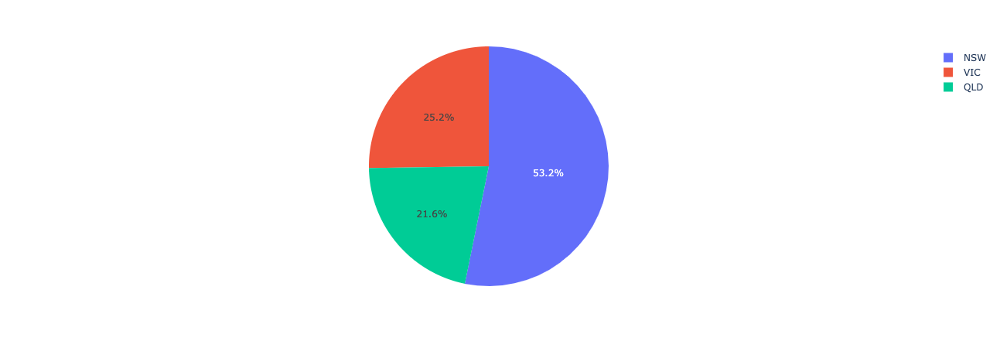

In [384]:
px.pie(revenue_generation, 'state', 'list_price')

In [432]:
stacked = common_df.groupby(['state', 'gender'])['list_price'].sum().reset_index().pivot(columns='gender', index='state')['list_price']

In [404]:
from plotly import graph_objects as go

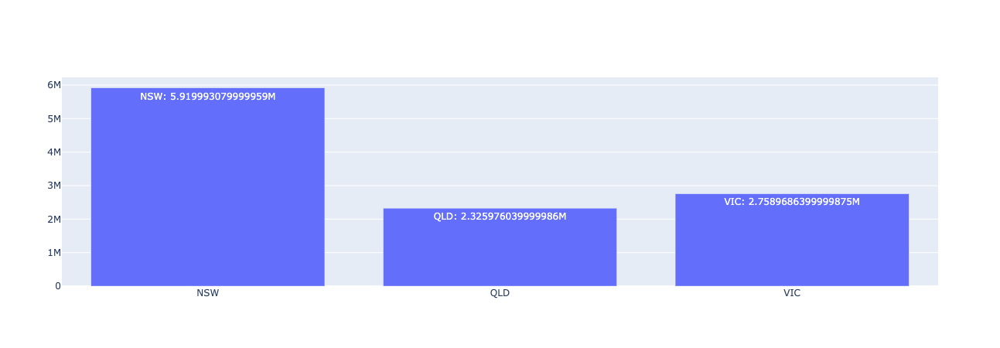

In [1038]:
indices = list(stacked.index)
fig = go.Figure(go.Bar(x=indices, y=stacked.iloc[:, 0].values, name='Female', texttemplate = "%{label}: %{value:1s}",
                      textposition = "inside"))
fig.show()

gender
Female    5919993.08
Male      5573708.53
U          273893.48
Name: NSW, dtype: float64

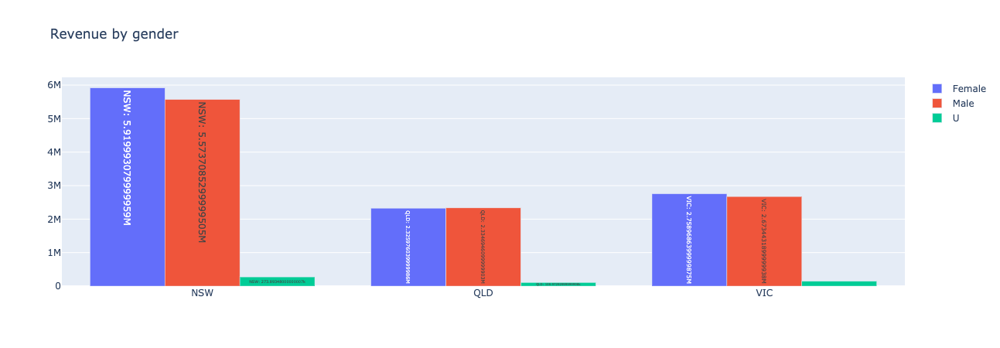

In [1046]:
fig = go.Figure()
for num, col in enumerate(stacked.columns):
    fig.add_trace(go.Bar(x=indices, y=stacked[col].values, name=f'{col}', texttemplate = "%{label}: %{value:s}",
                      textposition = "inside"))

fig.update_layout(barmode='group', 
                  xaxis={'categoryorder':'category ascending'},
                 title={'text': 'Revenue by gender'})
fig.show()

In [1024]:
brand = common_df.groupby(['brand'])['list_price'].sum().to_frame()

In [1025]:
brand.sort_values('list_price', ascending=False, inplace=True)

In [1026]:
brand.reset_index(inplace=True)

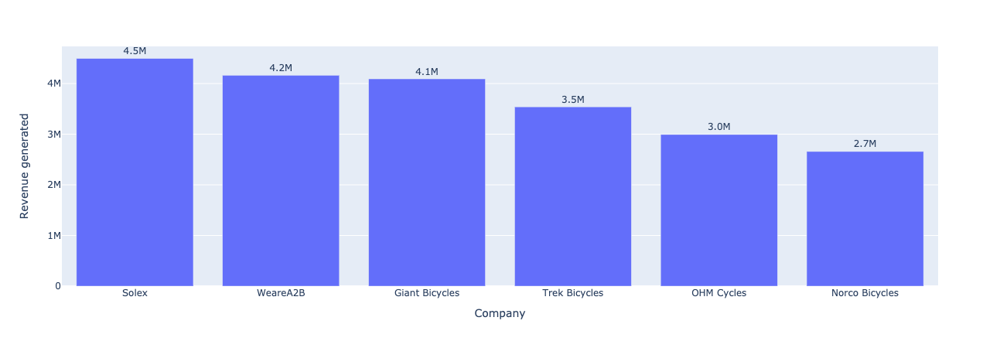

In [1036]:
fig = px.bar(brand, x='brand', y='list_price')
fig.update_traces(texttemplate='%{value:.2s}', textposition='outside')
fig.update_layout(xaxis={'title': 'Company'},
                 yaxis={'title': 'Revenue generated'})
fig.show()

In [526]:
brand_gender = common_df.groupby(['brand', 'gender'])['list_price'].sum().reset_index()

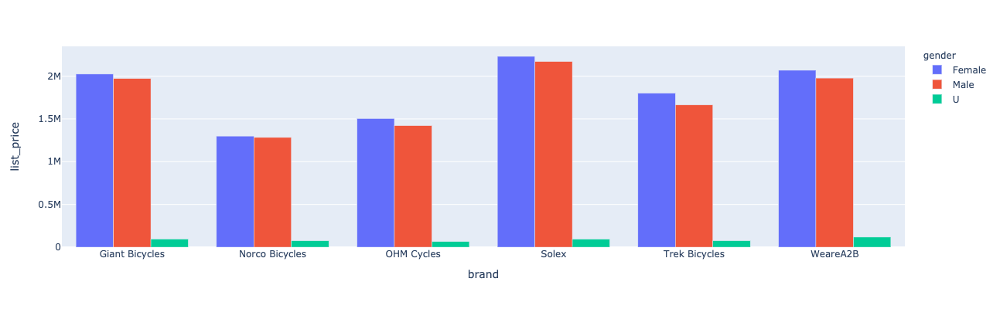

In [527]:
fig = px.bar(brand_gender, x="brand", y="list_price",
             color='gender', barmode='group',
             height=400)
fig.show()

In [528]:
brand_gender_count = common_df.groupby(['brand', 'gender'])['list_price'].size().reset_index()

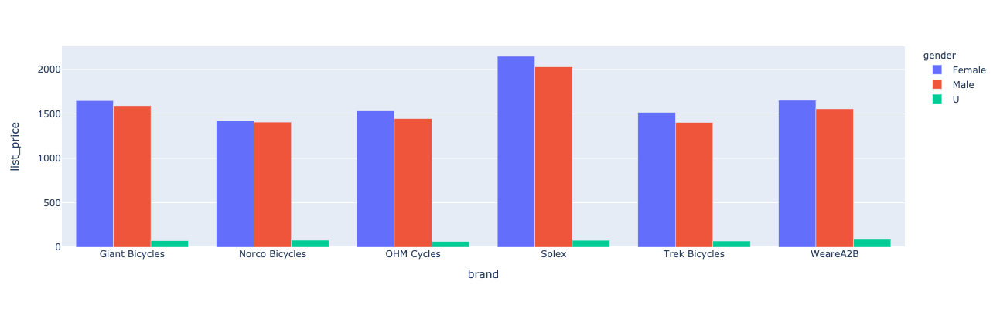

In [529]:
fig = px.bar(brand_gender_count, x="brand", y="list_price",
             color='gender', barmode='group',
             height=400)
fig.show()

In [530]:
common_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 20000 entries, 0 to 19999
Data columns (total 29 columns):
customer_id                            20000 non-null int64
transaction_id                         20000 non-null int64
product_id                             20000 non-null int64
transaction_date                       20000 non-null datetime64[ns]
online_order                           19640 non-null float64
order_status                           20000 non-null object
brand                                  19803 non-null object
product_line                           19803 non-null object
product_class                          19803 non-null object
product_size                           19803 non-null object
list_price                             20000 non-null float64
standard_cost                          19803 non-null float64
product_first_sold_date                19803 non-null float64
first_name                             19997 non-null object
last_name                   

In [531]:
frequency_job = common_df.groupby(['job_industry_category']).size().reset_index()

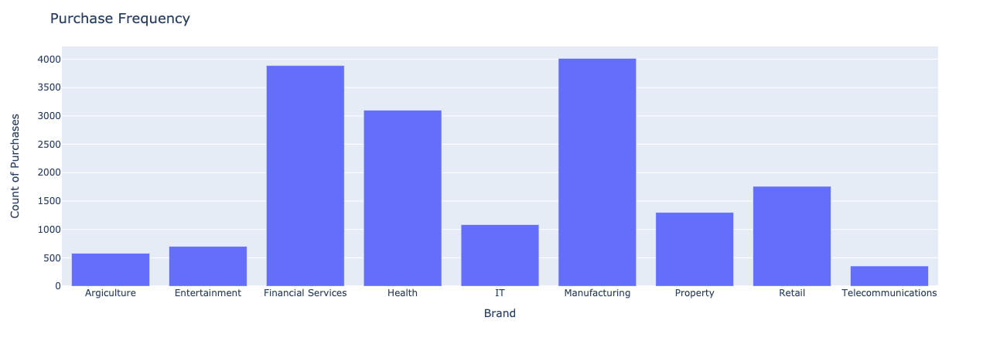

In [557]:
fig = go.Figure(px.bar(frequency_job, x='job_industry_category', y=0))
# Updating xaxis and y axis
fig.update_layout(title_text="Purchase Frequency",
                  title_font_size=18,
                 xaxis={"title_text":"Brand"},
                 yaxis=dict(title_text="Count of Purchases"))
fig.show()


### Mean purchase across industries

In [1050]:
fr = common_df.groupby(['job_industry_category', 'customer_id'])['customer_id'].count().to_frame().rename(columns={'customer_id': 'count'}).reset_index()[['job_industry_category', 'customer_id', 'count']]

In [1051]:
mean_purchase = fr.groupby(['job_industry_category'])['count'].mean()

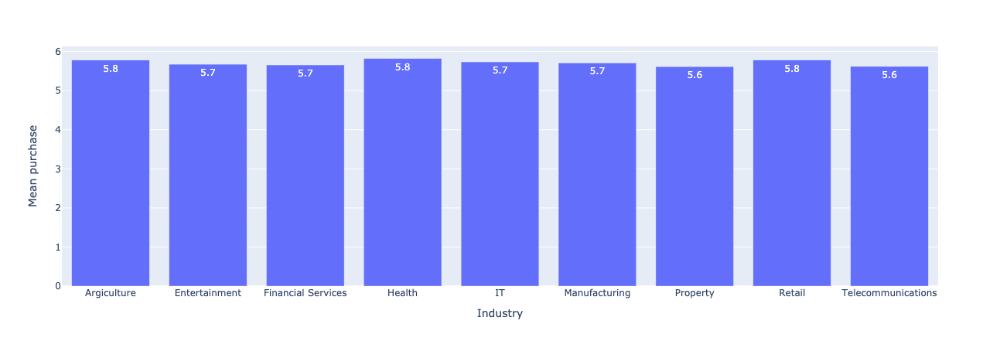

In [1069]:
fig = px.bar(mean_purchase.to_frame(), x=mean_purchase.index, y='count')
fig.update_traces(texttemplate='%{value:1.2s}')
fig.update_layout(yaxis={'title': 'Mean purchase'},
                 xaxis={'title': 'Industry'})

### Mean purchase across brands 

In [613]:
fb = common_df.groupby(['brand', 'customer_id'])['customer_id'].count().to_frame().rename(columns={'customer_id': 'count'}).reset_index()[['brand', 'customer_id', 'count']]

In [616]:
mean_purchase = fb.groupby(['brand'])['count'].mean()

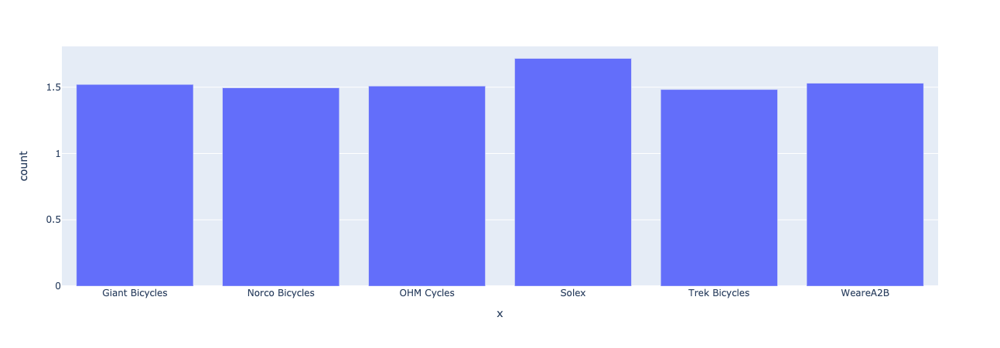

In [617]:
px.bar(mean_purchase.to_frame(), x=mean_purchase.index, y='count')

### Mean purchase of bikes of those, who do not own car

In [691]:
fb = fr = common_df[common_df['owns_car']=='No'].groupby(['brand', 'customer_id'])['customer_id'].count().to_frame().rename(columns={'customer_id': 'count'}).reset_index()[['brand', 'customer_id', 'count']]

In [692]:
mean_purchase = fb.groupby(['brand'])['count'].mean()

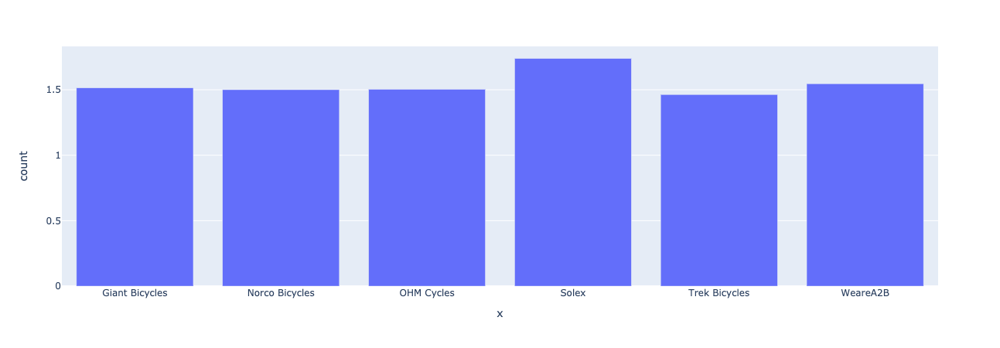

In [693]:
px.bar(mean_purchase.to_frame(), x=mean_purchase.index, y='count')

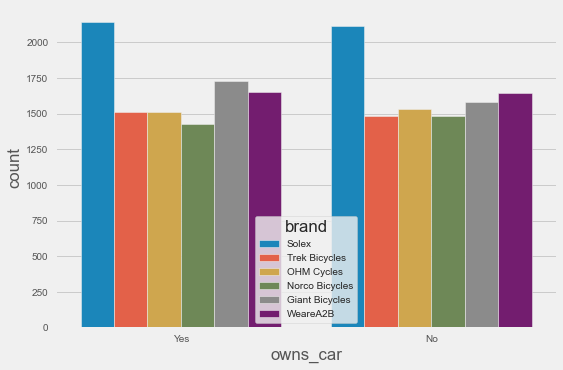

In [701]:
sns.countplot(data=common_df, x='owns_car', hue='brand')

### Bike sold by months

In [661]:
month_purchase = common_df.groupby(['transaction_date', 'brand'])['customer_id'].count()

In [662]:
month_purchase = month_purchase.reset_index().pivot(columns='brand', index='transaction_date')['customer_id']

In [663]:
MoM = month_purchase.resample('M').sum()

In [664]:
MoM = MoM.unstack().reset_index().set_index('transaction_date')

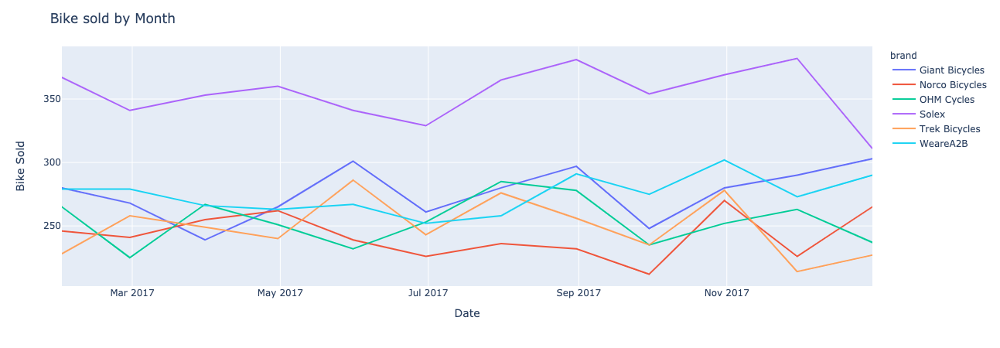

In [671]:
fig = go.Figure(px.line(MoM.reset_index(), x='transaction_date', y=0, color='brand'))
fig.update_layout(xaxis={'title': 'Date'},
                 yaxis={'title': 'Bike Sold'},
                 title={'text': 'Bike sold by Month'})
fig.show()

### What is the range of prices across brands

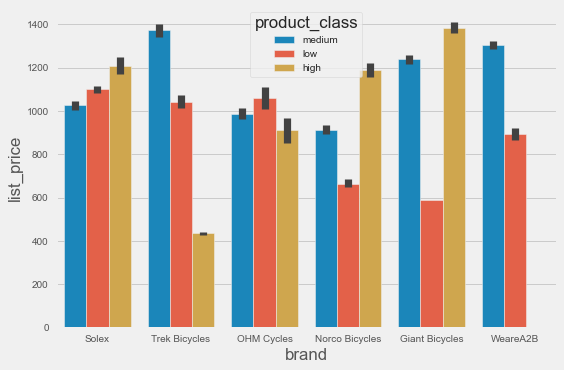

In [677]:
sns.barplot(data=common_df, y='list_price', x='brand', hue='product_class')

In [680]:
def perc_25(x):
    return np.percentile(x, 2.5)
def perc_975(x):
    return np.percentile(x, 97.5)

In [682]:
piv_table = pd.pivot_table(common_df_nn, values='list_price', index='brand', aggfunc= [np.mean, np.median, min, max, np.var, np.std, perc_25, perc_975])

In [683]:
piv_table

,mean,median,min,max,var,std,perc_25,perc_975
,list_price,list_price,list_price,list_price,list_price,list_price,list_price,list_price
brand,,,,,,,,
Giant Bicycles,1236.803194,1311.44,230.91,1977.36,256167.998649,506.130417,230.91,1977.36
Norco Bicycles,914.603191,958.74,360.40,1661.92,163650.445103,404.537322,360.40,1661.92
OHM Cycles,986.810806,1073.07,12.01,2005.66,429954.485261,655.709147,12.01,2005.66
Solex,1059.125288,1071.23,71.49,2083.94,367783.724607,606.451750,71.49,2083.94
Trek Bicycles,1200.422128,1057.51,290.62,2091.47,421630.575481,649.330867,290.62,2091.47
WeareA2B,1258.676333,1292.84,60.34,1992.93,298290.818372,546.160067,60.34,1992.93


In [684]:
common_df_nn['brand'].unique()

array(['Solex', 'Trek Bicycles', 'OHM Cycles', 'Norco Bicycles',
       'Giant Bicycles', 'WeareA2B'], dtype=object)

In [690]:
for col in list(common_df_nn['brand'].unique()):
    print(f'Skewness of {col} is {common_df_nn[common_df_nn["brand"] == col]["list_price"].skew():.1f}')
    print(f'Kurtosis of {col} is {common_df_nn[common_df_nn["brand"] == col]["list_price"].kurt():.1f}\n')

Skewness of Solex is -0.1
Kurtosis of Solex is -1.1

Skewness of Trek Bicycles is 0.0
Kurtosis of Trek Bicycles is -1.6

Skewness of OHM Cycles is -0.1
Kurtosis of OHM Cycles is -1.3

Skewness of Norco Bicycles is 0.3
Kurtosis of Norco Bicycles is -1.1

Skewness of Giant Bicycles is -0.4
Kurtosis of Giant Bicycles is -0.9

Skewness of WeareA2B is -0.7
Kurtosis of WeareA2B is -0.2



### What age makes the most revenue for companies?

In [715]:
from dateutil.relativedelta import relativedelta

In [768]:
def customer_age(customer_id):
    end_date = check_date[check_date['customer_id'] == customer_id]['transaction_date'].min().date()
    bod = check_date[check_date['customer_id'] == customer_id]['DOB'].values[0].astype('M8[D]').astype('O')
    return relativedelta(end_date, bod).years

In [717]:
check_date = common_df.copy()

In [769]:
check_date['age'] = check_date['customer_id'].progress_apply(customer_age)

100%|██████████| 20000/20000 [00:36<00:00, 550.22it/s]


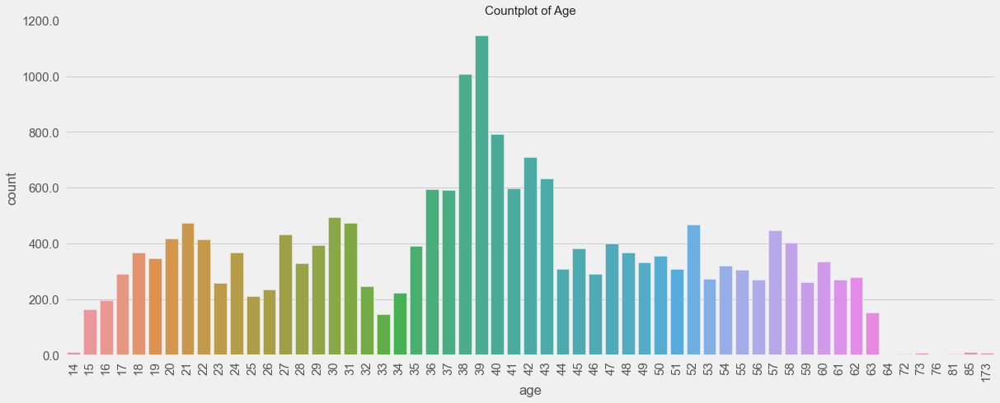

In [781]:
fig = plt.figure(figsize=(18, 7))
fig = sns.countplot(data=check_date[check_date['DOB'].notnull()] , x='age')
# Showing yticks
fig.set_yticklabels(fig.get_yticks(), size = 15)
# Setting xticks
_, xlabels = plt.xticks()
fig.set_xticklabels(xlabels, size = 15)
# Setting title
fig.set_title('Countplot of Age', fontdict={'fontsize':15
})
              
plt.xticks(rotation=90)
plt.show()

In [782]:
check_date['age'].mean()

38.1965

In [783]:
check_date['age'].kurt()

3.5129814826980397

In [784]:
check_date['age'].skew()

0.09906050266688846

In [785]:
check_date['age'].std()

14.033429182018569

### Average check of transaction across age

In [814]:
avg_age = check_date[check_date['DOB'].notnull()]

In [816]:
avg_age = avg_age.groupby(['brand', 'age'])['age'].count().rename(columns={0: 'count'}).reset_index()

In [817]:
avg_age

,brand,age,0
0,Giant Bicycles,14,3
1,Giant Bicycles,15,21
2,Giant Bicycles,16,37
3,Giant Bicycles,17,41
4,Giant Bicycles,18,71
...,...,...,...
318,WeareA2B,62,52
319,WeareA2B,63,21
320,WeareA2B,73,1
321,WeareA2B,85,1


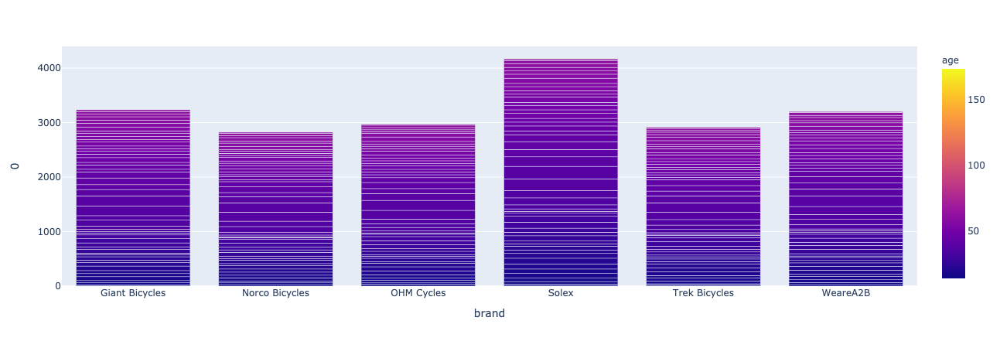

In [818]:
px.bar(avg_age, x='brand', y=0, color='age')

In [835]:
check_date = check_date[(check_date['DOB'].notnull()) & (check_date['age'] < 100)]

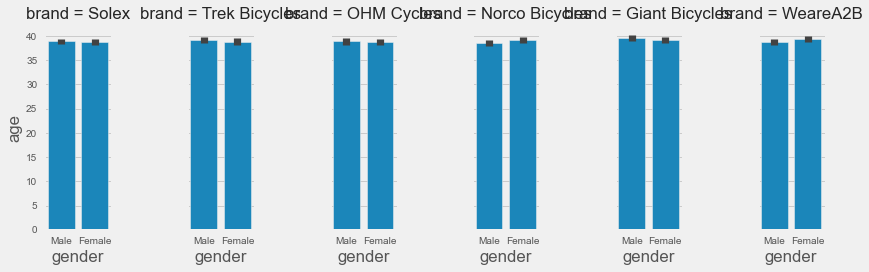

In [851]:
# fig = plt.figure(figsize=(28, 10))
fig = sns.FacetGrid(check_date, col='brand', height=4, aspect=.5)
fig.map(sns.barplot, 'gender', "age");
# g.set(xlabel='Condition of apartments', ylabel='House Price')

In [853]:
brands_hist = check_date[check_date['DOB'].notnull()]

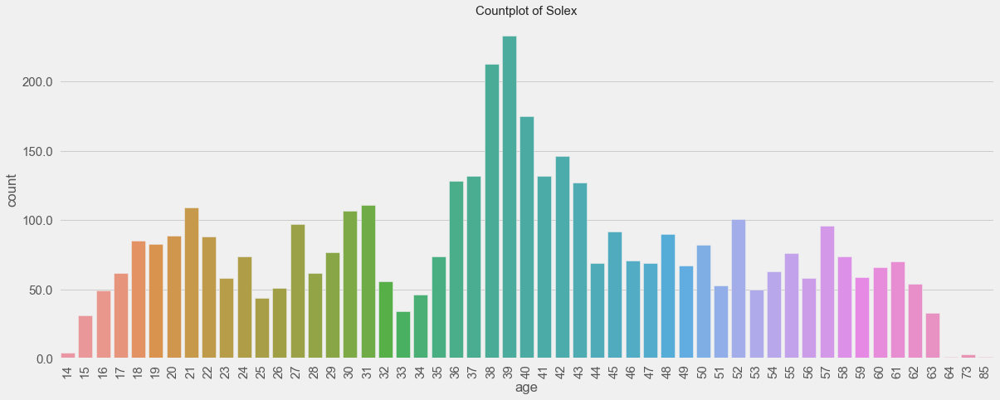

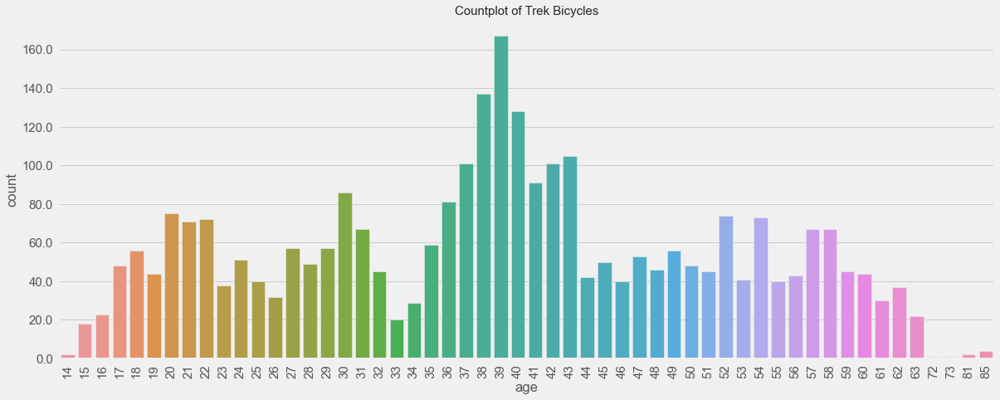

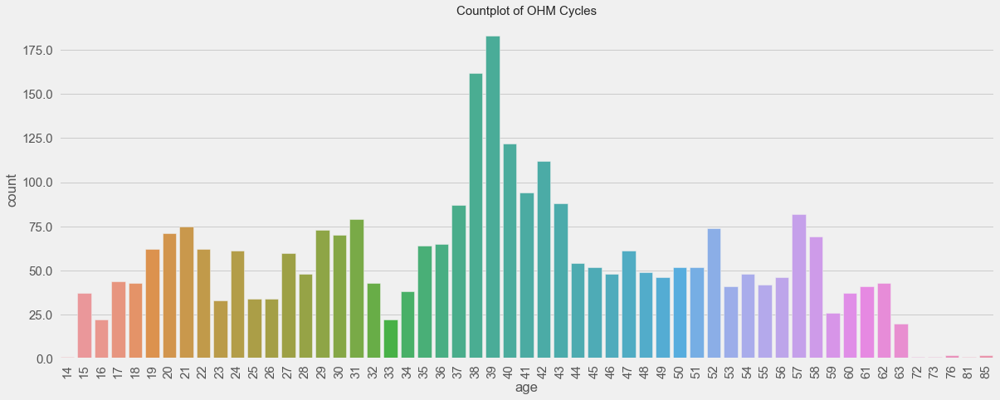

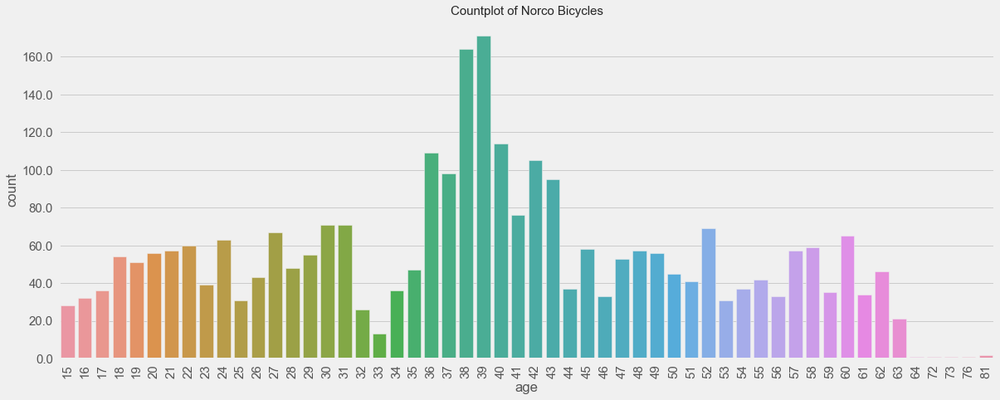

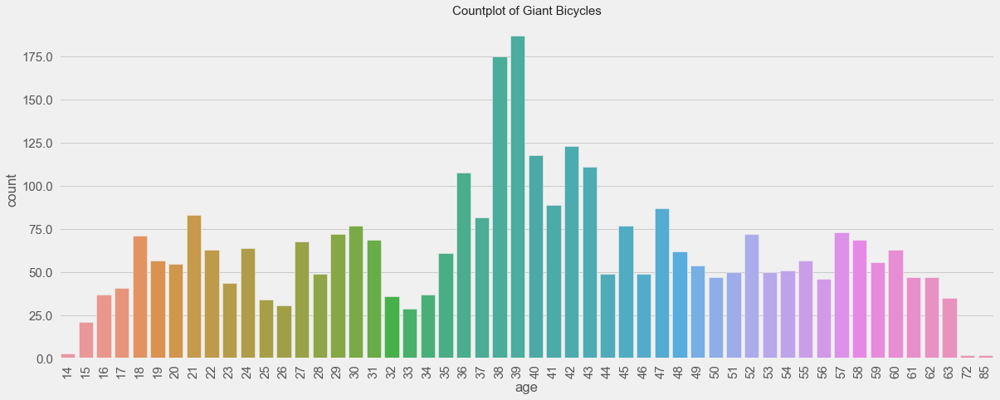

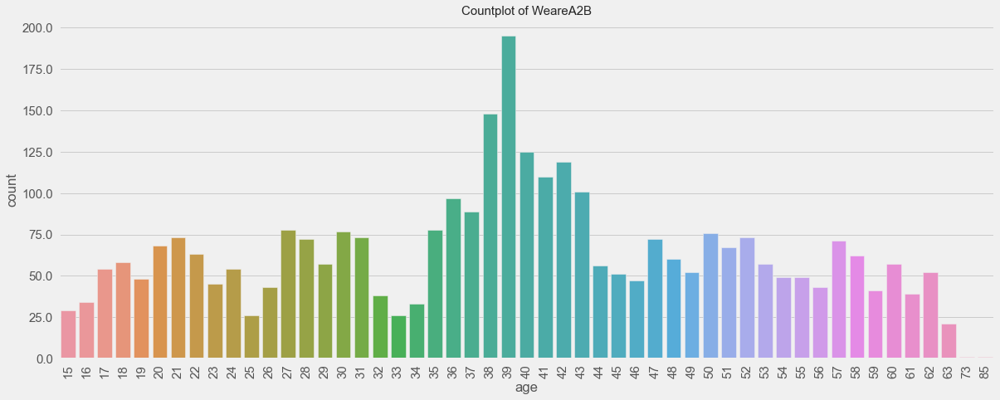

ValueError: min() arg is an empty sequence

<Figure size 1296x504 with 0 Axes>

In [860]:
for brand in list(brands_hist['brand'].unique()):
    fig = plt.figure(figsize=(18, 7))
    fig = sns.countplot(data= brands_hist[brands_hist['brand']==brand], x='age')
    # Showing yticks
    fig.set_yticklabels(fig.get_yticks(), size = 15)
    # Setting xticks
    _, xlabels = plt.xticks()
    fig.set_xticklabels(xlabels, size = 15)
    # Setting title
    fig.set_title(f'Countplot of {brand}', fontdict={'fontsize':15
    })

    plt.xticks(rotation=90)
    plt.show()

In [864]:
sum_by_age = brands_hist.groupby(['brand', 'age'])['list_price'].sum().reset_index()

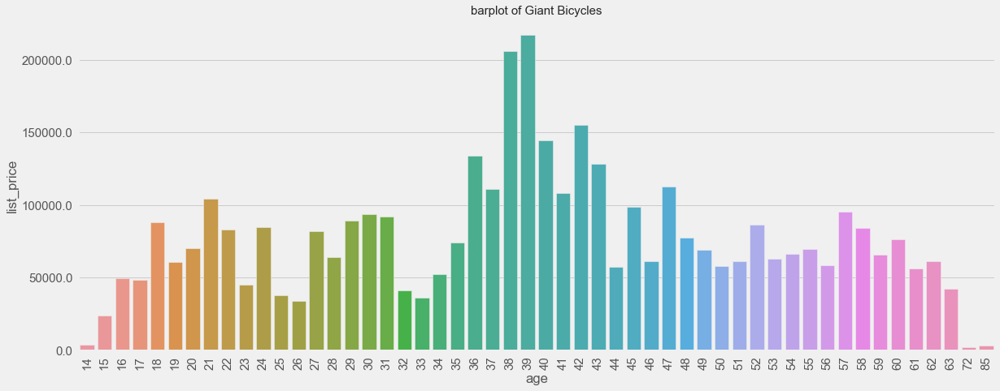

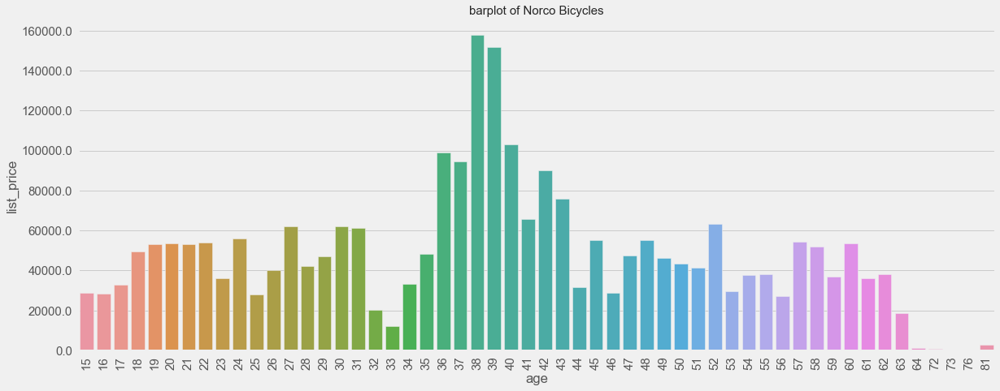

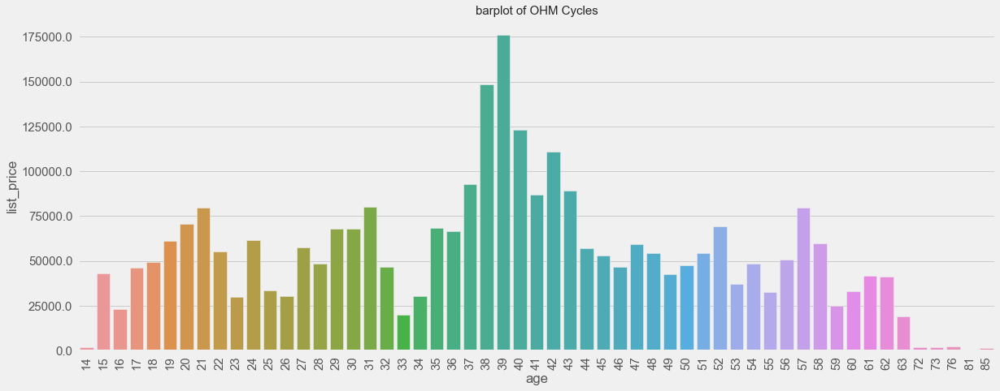

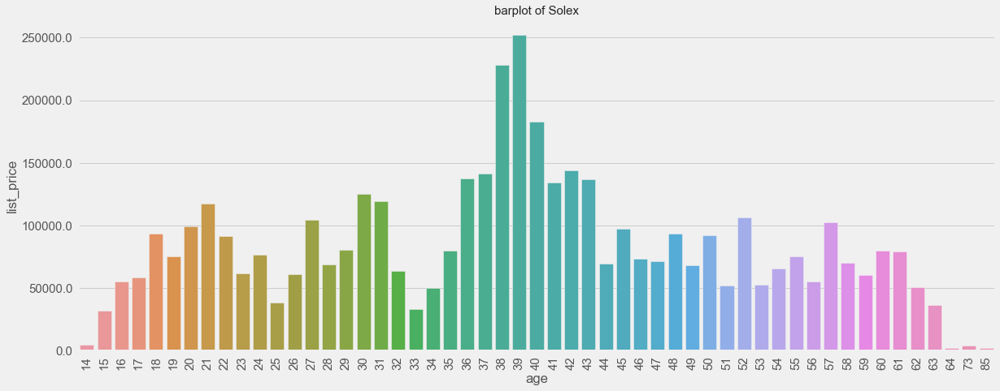

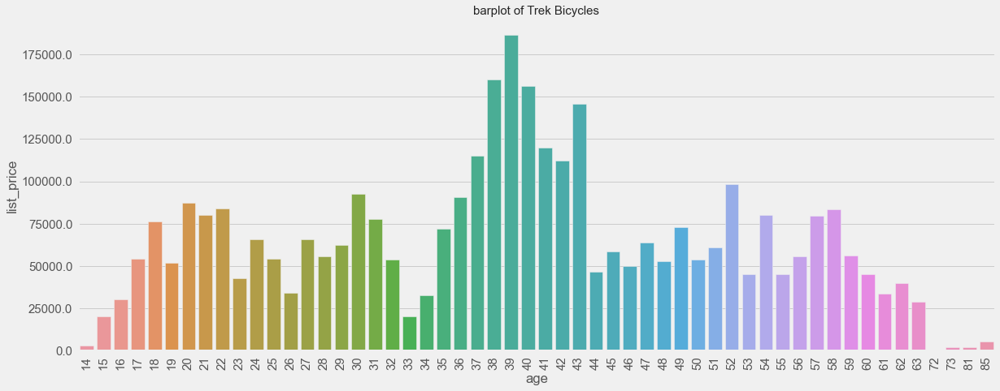

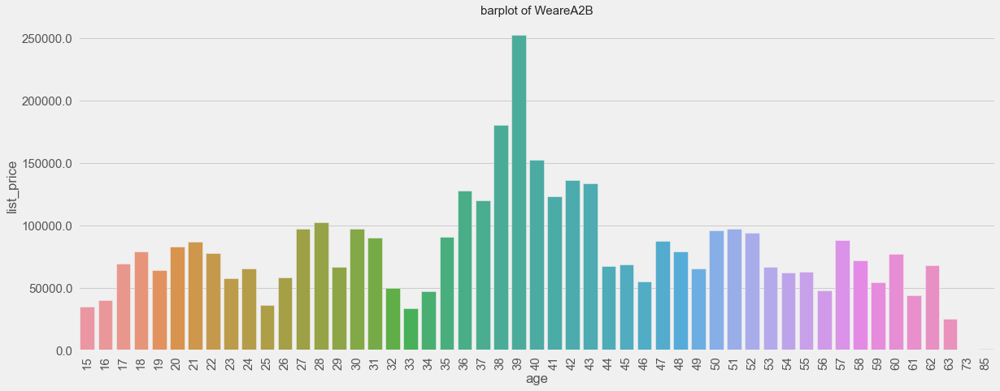

In [865]:
for brand in list(sum_by_age['brand'].unique()):
    fig = plt.figure(figsize=(18, 7))
    fig = sns.barplot(data= sum_by_age[sum_by_age['brand']==brand], y='list_price', x='age')
    # Showing yticks
    fig.set_yticklabels(fig.get_yticks(), size = 15)
    # Setting xticks
    _, xlabels = plt.xticks()
    fig.set_xticklabels(xlabels, size = 15)
    # Setting title
    fig.set_title(f'barplot of {brand}', fontdict={'fontsize':15
    })

    plt.xticks(rotation=90)
    plt.show()

In [924]:
brands_hist = brands_hist[brands_hist['order_status'] != 'Cancelled']

In [931]:
np.arange(0, 85, 4)

array([ 0,  4,  8, 12, 16, 20, 24, 28, 32, 36, 40, 44, 48, 52, 56, 60, 64,
       68, 72, 76, 80, 84])

In [984]:
bin_labels = ['0-4', '5-9', '10-14', '15-19', '20-24', '25-29', '30-34', '35-39', '40-44', '45-49', '50-54',
             '55-59', '60-64', '65-69', '70-74', '75-79', '80-84', '85+']

brands_hist.loc[:, 'age_bins'] = pd.cut(brands_hist['age'],
                              bins=np.arange(0, 95, 5),
                              labels=bin_labels,
                                right=False) # not including right number [nums)

In [1019]:
brands_hist.sample(2)

,customer_id,transaction_id,product_id,transaction_date,online_order,order_status,brand,product_line,product_class,product_size,list_price,standard_cost,product_first_sold_date,first_name,last_name,gender,past_3_years_bike_related_purchases,DOB,job_title,job_industry_category,wealth_segment,deceased_indicator,owns_car,tenure,address,postcode,state,country,property_valuation,age,age_bins
8802,3003,8803,24,2017-07-30,1.0,Approved,Solex,Road,medium,large,1777.8,820.78,33552.0,Brita,Tupie,Female,72.0,1963-05-02,Web Developer I,Retail,Mass Customer,N,Yes,4.0,78 Algoma Circle,2166.0,NSW,Australia,8.0,53,50-54
3469,2291,3470,69,2017-09-14,1.0,Approved,Giant Bicycles,Road,medium,medium,792.9,594.68,41922.0,Guido,Meynell,Male,67.0,1971-04-13,Accountant IV,Manufacturing,Affluent Customer,N,Yes,4.0,91 Ilene Parkway,3630.0,VIC,Australia,1.0,46,45-49


In [1010]:
brands_hist['age_bins'] = brands_hist['age_bins'].astype(str)

<ipython-input-1010-6adbf379733b>:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [1012]:
brands_hist.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 19365 entries, 0 to 19999
Data columns (total 31 columns):
customer_id                            19365 non-null int64
transaction_id                         19365 non-null int64
product_id                             19365 non-null int64
transaction_date                       19365 non-null datetime64[ns]
online_order                           19019 non-null float64
order_status                           19365 non-null object
brand                                  19178 non-null object
product_line                           19178 non-null object
product_class                          19178 non-null object
product_size                           19178 non-null object
list_price                             19365 non-null float64
standard_cost                          19178 non-null float64
product_first_sold_date                19178 non-null float64
first_name                             19365 non-null object
last_name                   

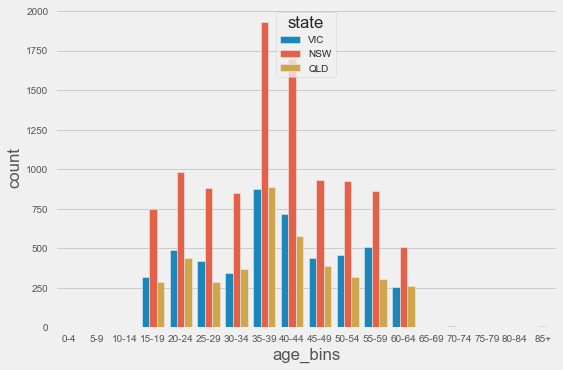

In [1020]:
sns.countplot(data=brands_hist, x='age_bins', hue='state')

### Online purchase vs offline

#### Items sold by companies

In [885]:
common_df.sample(2)

,customer_id,transaction_id,product_id,transaction_date,online_order,order_status,brand,product_line,product_class,product_size,list_price,standard_cost,product_first_sold_date,first_name,last_name,gender,past_3_years_bike_related_purchases,DOB,job_title,job_industry_category,wealth_segment,deceased_indicator,owns_car,tenure,address,postcode,state,country,property_valuation
5857,2454,5858,87,2017-08-31,0.0,Approved,Giant Bicycles,Standard,high,medium,1179.0,707.40,36145.0,Gene,Brome,Female,81.0,1960-02-13,Senior Sales Associate,Property,Mass Customer,N,Yes,12.0,15 Shelley Hill,2164.0,NSW,Australia,8.0
9425,3390,9426,12,2017-03-12,0.0,Approved,Giant Bicycles,Standard,medium,large,1765.3,709.48,38193.0,Fayth,Baudins,Female,20.0,1969-01-27,NaN,NaN,High Net Worth,N,No,7.0,10097 Hooker Way,3196.0,VIC,Australia,8.0


In [880]:
items_sold = common_df.copy()

In [872]:
def customer_age(df, customer_id):
    end_date = df[df['customer_id'] == customer_id]['transaction_date'].min().date()
    bod = df[df['customer_id'] == customer_id]['DOB'].values[0].astype('M8[D]').astype('O')
    return relativedelta(end_date, bod).years

In [881]:
items_sold['age'] = common_df['customer_id'].progress_apply(lambda x: customer_age(common_df, x))

100%|██████████| 20000/20000 [00:34<00:00, 574.99it/s]


In [883]:
items_sold = items_sold[(items_sold['order_status'] != 'Cancelled') & (items_sold['age'] < 100) & (items_sold['age'] >= 16)]

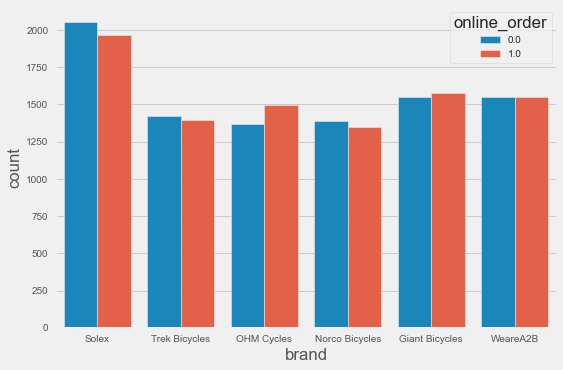

In [890]:
sns.countplot(data=items_sold, x='brand', hue='online_order')

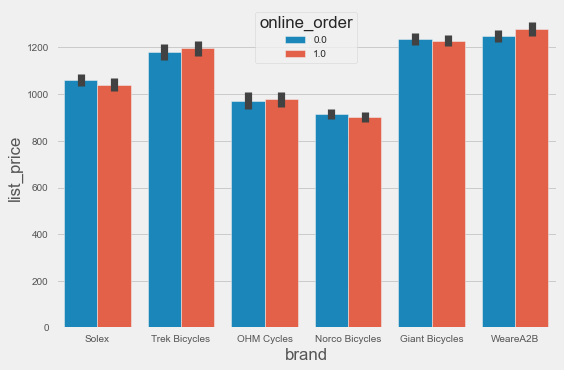

In [891]:
sns.barplot(data=items_sold, x='brand', y='list_price', hue='online_order')

In [886]:
items_sold_online = items_sold[items_sold['online_order'] == 1]

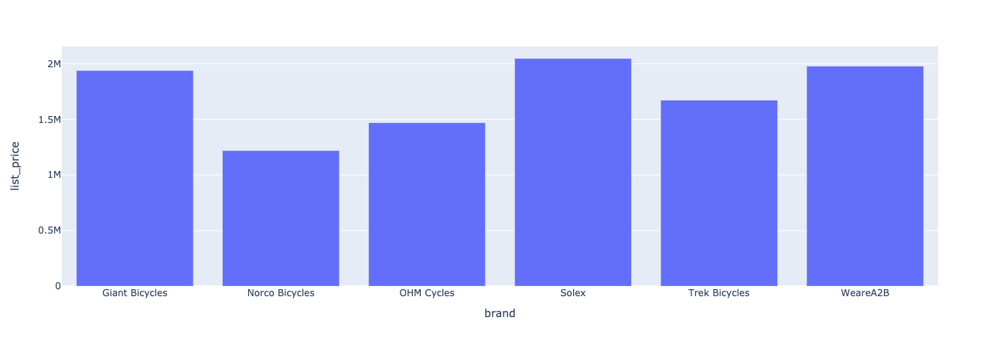

In [896]:
px.bar(items_sold_online.groupby(['brand'])['list_price'].sum().to_frame().reset_index(), x='brand', y='list_price')

In [892]:
items_sold_offline = items_sold[items_sold['online_order'] == 0]

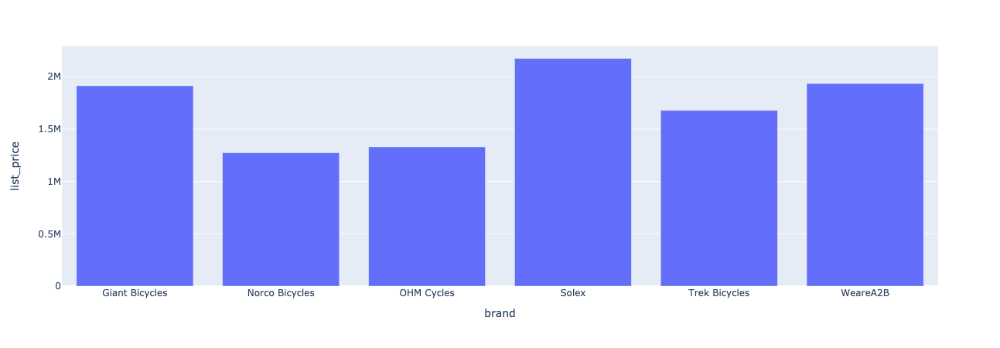

In [897]:
px.bar(items_sold_offline.groupby(['brand'])['list_price'].sum().to_frame().reset_index(), x='brand', y='list_price')

#### Revenues by companies

In [905]:
group_bar = items_sold.groupby(['brand', 'online_order'])['list_price'].sum().to_frame().reset_index()

In [906]:
group_bar['online_order'] = group_bar['online_order'].astype(str)

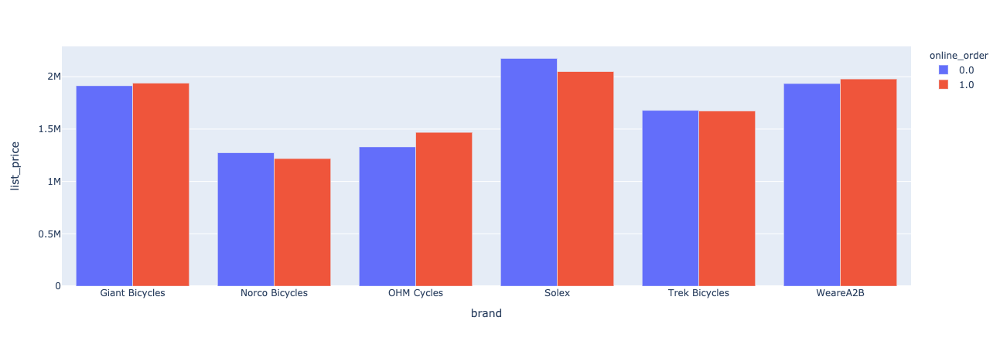

In [907]:
px.bar(group_bar, x='brand', y='list_price', color='online_order', barmode='group')

#### Average paycheck

In [911]:
count_bike = items_sold.groupby(['brand', 'online_order'])['customer_id'].count().reset_index()

In [912]:
revenue_bike = items_sold.groupby(['brand', 'online_order'])['list_price'].sum().reset_index()

In [913]:
# Merge amount of bikes and revenues
avg_paycheck = revenue_bike.merge(count_bike, how='left', on=['brand', 'online_order'])

In [917]:
avg_paycheck['avg_paycheck'] = avg_paycheck['list_price']/avg_paycheck['customer_id']

In [919]:
avg_paycheck['online_order'] = avg_paycheck['online_order'].astype(str)

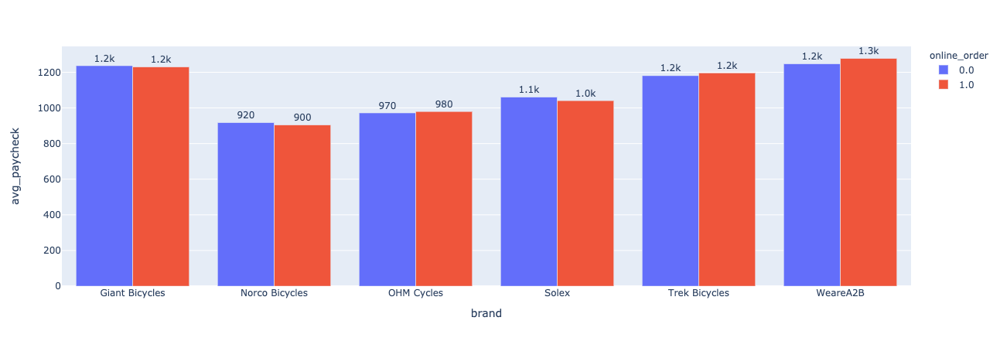

In [922]:
fig = px.bar(avg_paycheck, x='brand', y='avg_paycheck', color='online_order', barmode='group')
fig.update_traces(texttemplate='%{value:.2s}', textposition='outside')
fig.update_layout(uniformtext_minsize=8, uniformtext_mode='hide')
fig.show()

## Methodoly of choosing 1000 clients
- Filtering accepted transactions
- Age between 36-43 years old
- New South Wales state
- Solex, WearA2B, Giant Bycicles companies
- Financial Servics, Health, Manufacturing industries

In [1071]:
common_df['age'] = common_df['customer_id'].progress_apply(lambda x: customer_age(common_df, x))
common_df = common_df[(items_sold['order_status'] != 'Cancelled') & (common_df['age'] < 100) & (common_df['age'] >= 16)]

100%|██████████| 20000/20000 [00:37<00:00, 529.33it/s]


In [1073]:
bin_labels = ['0-4', '5-9', '10-14', '15-19', '20-24', '25-29', '30-34', '35-39', '40-44', '45-49', '50-54',
             '55-59', '60-64', '65-69', '70-74', '75-79', '80-84', '85+']

common_df.loc[:, 'age_bins'] = pd.cut(common_df['age'],
                              bins=np.arange(0, 95, 5),
                              labels=bin_labels,
                                right=False) # not including right number [nums)

/Library/Frameworks/Python.framework/Versions/3.8/lib/python3.8/site-packages/pandas/core/indexing.py:376: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [1074]:
common_df.to_csv('for_tableau.csv')